# Spatial Regression Models

In [1]:
from pysal.lib import weights
from pysal.explore import esda 
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
import re
import contextily as ctx

/home/biscotty/Learning/AppliedGeospatial/_build/pip_packages/lib/python3.12/site-packages/spaghetti/network.py:41: FutureWarning: The next major release of pysal/spaghetti (2.0.0) will drop support for all ``libpysal.cg`` geometries. This change is a first step in refactoring ``spaghetti`` that is expected to result in dramatically reduced runtimes for network instantiation and operations. Users currently requiring network and point pattern input as ``libpysal.cg`` geometries should prepare for this simply by converting to ``shapely`` geometries.
  warnings.warn(dep_msg, FutureWarning, stacklevel=1)


In [2]:
listings = pd.read_csv('../data/listings.csv.gz')
listings_gdf = gpd.GeoDataFrame(
    listings, 
    geometry=gpd.points_from_xy(
        listings.longitude, listings.latitude
    ), 
    crs=4326
)

In [3]:
boroughs = gpd.read_file('../data/NYC_Boroughs/nybb_22a/nybb.shp')
manhattan = boroughs[boroughs.BoroName == 'Manhattan']
manhattan = manhattan.to_crs(4326)

In [4]:
listings_mask = listings_gdf.within(manhattan.loc[3,'geometry'])
listings_manhattan = listings_gdf.loc[listings_mask]

In [5]:
cois = ['id', 'room_type', 'accommodates', 'bedrooms', 
       'price', 'beds', 'review_scores_rating', 'neighbourhood_cleansed']
listings_manhattan_subset = listings_manhattan.copy()[cois]

In [6]:
listings_manhattan_subset.info()

<class 'pandas.core.frame.DataFrame'>
Index: 16463 entries, 0 to 37540
Data columns (total 8 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   id                      16463 non-null  int64  
 1   room_type               16463 non-null  object 
 2   accommodates            16463 non-null  int64  
 3   bedrooms                14121 non-null  float64
 4   price                   9923 non-null   object 
 5   beds                    9819 non-null   float64
 6   review_scores_rating    10557 non-null  float64
 7   neighbourhood_cleansed  16463 non-null  object 
dtypes: float64(3), int64(2), object(3)
memory usage: 1.1+ MB


In [7]:
listings_manhattan_subset.room_type.unique()

array(['Entire home/apt', 'Private room', 'Shared room', 'Hotel room'],
      dtype=object)

>Categorical encoding with 0 = hotel room

In [8]:
lms = listings_manhattan_subset.copy()

In [9]:
lms['rt_entire_home_apt'] = [1 if lm == 'Entire home/apt' 
                             else 0 
                             for lm in lms.room_type]

In [10]:
lms['rt_private_room'] = [1 if lm == 'Private room' 
                             else 0 
                             for lm in lms.room_type]

In [11]:
lms['rt_shared_room'] = [1 if lm == 'Shared room' 
                             else 0 
                             for lm in lms.room_type]

In [12]:
lms['price'] = [float(re.sub('[,$]', '', str(price))) for price in lms.price]

In [13]:
lms['log_price'] = np.log(lms.price)

In [14]:
lms.price

0        240.0
2         65.0
3         71.0
8        175.0
11        75.0
         ...  
37524    309.0
37527     63.0
37529    159.0
37534    195.0
37540    230.0
Name: price, Length: 16463, dtype: float64

In [15]:
print('Total Records:', len(lms))
lms.isna().sum()

Total Records: 16463


id                           0
room_type                    0
accommodates                 0
bedrooms                  2342
price                     6540
beds                      6644
review_scores_rating      5906
neighbourhood_cleansed       0
rt_entire_home_apt           0
rt_private_room              0
rt_shared_room               0
log_price                 6540
dtype: int64

In [16]:
lms.isna().sum()

id                           0
room_type                    0
accommodates                 0
bedrooms                  2342
price                     6540
beds                      6644
review_scores_rating      5906
neighbourhood_cleansed       0
rt_entire_home_apt           0
rt_private_room              0
rt_shared_room               0
log_price                 6540
dtype: int64

In [17]:
#lms = lms[
#    lms.bedrooms.notna() & 
#    lms.review_scores_rating.notna() & 
#    lms.beds.notna()
#]

In [18]:
lms = lms[lms['bedrooms'].notna()]
lms = lms[lms['review_scores_rating'].notna()]
lms = lms[lms['beds'].notna()]
lms.isna().sum()

id                        0
room_type                 0
accommodates              0
bedrooms                  0
price                     0
beds                      0
review_scores_rating      0
neighbourhood_cleansed    0
rt_entire_home_apt        0
rt_private_room           0
rt_shared_room            0
log_price                 0
dtype: int64

In [19]:
lms.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6161 entries, 0 to 37393
Data columns (total 12 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   id                      6161 non-null   int64  
 1   room_type               6161 non-null   object 
 2   accommodates            6161 non-null   int64  
 3   bedrooms                6161 non-null   float64
 4   price                   6161 non-null   float64
 5   beds                    6161 non-null   float64
 6   review_scores_rating    6161 non-null   float64
 7   neighbourhood_cleansed  6161 non-null   object 
 8   rt_entire_home_apt      6161 non-null   int64  
 9   rt_private_room         6161 non-null   int64  
 10  rt_shared_room          6161 non-null   int64  
 11  log_price               6161 non-null   float64
dtypes: float64(5), int64(5), object(2)
memory usage: 625.7+ KB


## Building the model

In [20]:
from pysal.model import spreg

In [21]:
m_vars = ['accommodates', 'bedrooms', 'beds', 'review_scores_rating', 
         'rt_entire_home_apt', 'rt_private_room', 'rt_shared_room']

In [22]:
ols_m = spreg.OLS(
    lms[['log_price']].values, 
    lms[m_vars].values, 
    name_y = 'price', 
    name_x = m_vars
)
print(ols_m.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :        None
Dependent Variable  :       price                Number of Observations:        6161
Mean dependent var  :      5.2409                Number of Variables   :           8
S.D. dependent var  :      0.7124                Degrees of Freedom    :        6153
R-squared           :      0.3481
Adjusted R-squared  :      0.3474
Sum squared residual:     2037.83                F-statistic           :    469.4386
Sigma-square        :       0.331                Prob(F-statistic)     :           0
S.E. of regression  :       0.575                Log likelihood        :   -5333.956
Sigma-square ML     :       0.331                Akaike info criterion :   10683.911
S.E of regression ML:      0.5751                Schwarz criterion     :   10737.719

------------------------------------------------------------

>Explore unmodeled spatial relationships

In [23]:
lms['ols_m_r'] = ols_m.u

In [24]:
#lms = lms.merge(listings_manhattan[['id', 'neighbourhood_cleansed']], 
#               how='left', on='id')

In [25]:
mean = (
    lms.groupby('neighbourhood_cleansed')
        .ols_m_r.mean()
        .to_frame("neighborhood_residual")
)

In [26]:
residuals_neighborhood = lms.merge(
    mean, how='left', 
    left_on='neighbourhood_cleansed', right_index=True
).sort_values('neighborhood_residual')

In [27]:
import plotly.express as px 
import plotly.io as pio 
from IPython.display import HTML

In [28]:
fig = px.violin(
    residuals_neighborhood, 
    x='neighbourhood_cleansed', 
    y='ols_m_r', 
    color='neighbourhood_cleansed'
)
fig.update_layout(
    xaxis_title='Neighborhood', 
    yaxis_title='Residuals'
)
HTML(fig.to_html())

In [29]:
nyc_n = gpd.read_file('../data/NYC_Neighborhoods/NYC_Neighborhoods.geojson')

In [30]:
nyc_n_r = nyc_n.merge(mean, left_on='neighborhood', right_on='neighbourhood_cleansed')

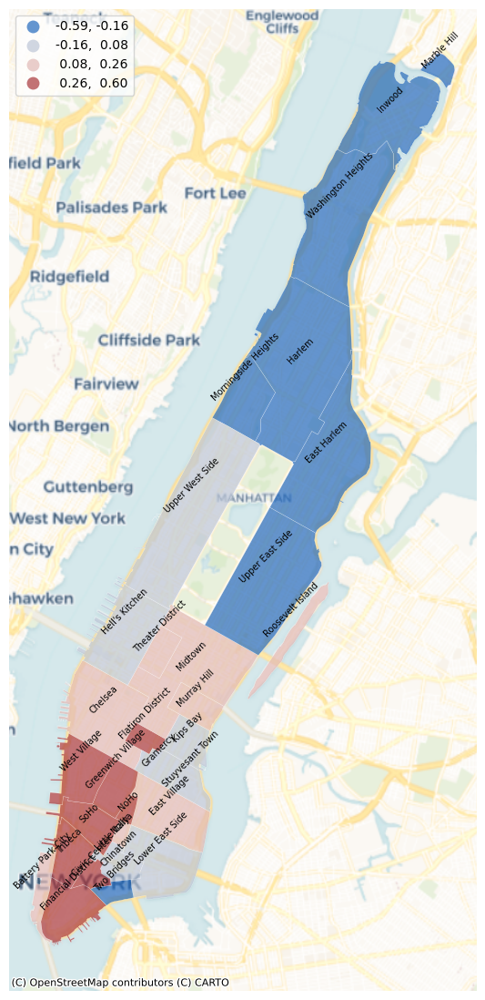

In [31]:
f, ax = plt.subplots(figsize=(8,14))
nyc_n_r.plot(
    column='neighborhood_residual', 
    cmap='vlag', 
    scheme='quantiles', 
    k=4, 
    edgecolor='white', 
    linewidth=0.2, 
    alpha=0.7, 
    legend=True, 
    ax=ax
)
ctx.add_basemap(ax, crs=nyc_n.crs, source=ctx.providers.CartoDB.Voyager)
for idx, row in nyc_n_r.iterrows(): 
    plt.annotate(text=row['neighborhood'], 
                xy=tuple([row.geometry.centroid.x, row.geometry.centroid.y]), 
                horizontalalignment='center', 
                fontsize=7, rotation=45)
ax.set_axis_off();

>residuals in one neighborhood are similar to those in proximity

>Checking geographic structure with spatial lags

In [33]:
residuals_neighborhood = residuals_neighborhood.merge(
    listings_manhattan[['id', 'geometry']], 
    how='left', on='id'
)

In [34]:
residuals_neighborhood.columns

Index(['id', 'room_type', 'accommodates', 'bedrooms', 'price', 'beds',
       'review_scores_rating', 'neighbourhood_cleansed', 'rt_entire_home_apt',
       'rt_private_room', 'rt_shared_room', 'log_price', 'ols_m_r',
       'neighborhood_residual', 'geometry'],
      dtype='object')

In [35]:
knn = weights.KNN.from_dataframe(residuals_neighborhood, k=5)

/home/biscotty/Learning/AppliedGeospatial/_build/pip_packages/lib/python3.12/site-packages/libpysal/weights/distance.py:153: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



In [36]:
lag_residual = weights.spatial_lag.lag_spatial(knn, ols_m.u)

In [63]:
fig = px.scatter(
    x=ols_m.u.flatten(),
    y = lag_residual.flatten(),
    trendline='ols', 
    width=800, height=800
)
fig.update_layout(
    xaxis_title='Airbnb Residuals', 
    yaxis_title='Spatially Lagged Residuals'
)
HTML(fig.to_html())

# Adding spatial elements to the model

In [41]:
nyc_attr_df = pd.read_csv('../data/NYC_Attractions/NYC Attractions.csv')
nyc_attr_gdf = gpd.GeoDataFrame(
    nyc_attr_df, 
    geometry=gpd.points_from_xy(
        nyc_attr_df.Longitude, nyc_attr_df.Latitude
    ), crs=4326
)

In [42]:
attractions = nyc_attr_gdf.Attraction.unique()
nyc_attr_gdf_proj = nyc_attr_gdf.to_crs(2263)
listings_manhattan_proj = listings_manhattan.to_crs(2263)

In [43]:
distances = listings_manhattan_proj.geometry.apply(
    lambda g: nyc_attr_gdf_proj.distance(g)
)

>to feet

In [44]:
distances.columns = attractions

In [45]:
distances = distances.apply(lambda x: x/5280, axis=1)

In [46]:
def d_calc(df, n): 
    return df.apply(lambda x: x <= n, axis=1).sum(axis=1)
distances_1mi = d_calc(distances, 1)
distances_2mi = d_calc(distances, 2)
distances_3mi = d_calc(distances, 3)
distances_4mi = d_calc(distances, 4)
distances_5mi = d_calc(distances, 5)
distances_6mi = d_calc(distances, 6)

In [47]:
distance_df = pd.concat([distances_1mi, distances_2mi, distances_3mi, 
                        distances_4mi, distances_5mi, distances_6mi], 
                       axis=1)
distance_df.columns = ['Attr_1mi','Attr_2mi','Attr_3mi','Attr_4mi',
'Attr_5mi','Attr_6mi']

In [48]:
listings_manhattan = listings_manhattan.merge(
    distance_df, left_index=True, right_index=True
)

In [49]:
listings_manhattan = listings_manhattan.merge(
    distances, left_index=True, right_index=True
)

# Proximity features

In [50]:
g_vars = ['Central Park','Central Park Zoo',
          'Empire State Building','Statue of Liberty',
          'Rockeffeller Center','Chrysler Building',
          'Times Square', 'MoMa', 'Charging Bull']

In [51]:
lms = lms.merge(
    listings_manhattan[['id'] + g_vars], how='left',on='id')

In [52]:
g_m_vars = m_vars + g_vars
ols_m_g = spreg.OLS(
    lms[['log_price']].values, 
    lms[g_m_vars].values, 
    name_y='price', 
    name_x=g_m_vars
)
print(ols_m_g.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :        None
Dependent Variable  :       price                Number of Observations:        6161
Mean dependent var  :      5.2409                Number of Variables   :          17
S.D. dependent var  :      0.7124                Degrees of Freedom    :        6144
R-squared           :      0.4892
Adjusted R-squared  :      0.4878
Sum squared residual:     1596.99                F-statistic           :    367.6912
Sigma-square        :       0.260                Prob(F-statistic)     :           0
S.E. of regression  :       0.510                Log likelihood        :   -4583.037
Sigma-square ML     :       0.259                Akaike info criterion :    9200.073
S.E of regression ML:      0.5091                Schwarz criterion     :    9314.415

------------------------------------------------------------

> Prior Adj R2: 0.3474, now 0.4878

In [54]:
model_diagnostics = pd.DataFrame(
    [[ols_m.r2, ols_m.ar2], [ols_m_g.r2, ols_m_g.ar2]],
    index=["OLS_M", "OLS_M_G"],
    columns=["R2", "Adj. R2"],
)

model_diagnostics

,R2,Adj. R2
OLS_M,0.348135,0.347393
OLS_M_G,0.489152,0.487822


In [55]:
lag_residual_2 = weights.spatial_lag.lag_spatial(knn, ols_m_g.u)
fig = px.scatter(
    x=ols_m_g.u.flatten(),
    y = lag_residual_2.flatten(),
    trendline='ols', 
    width=800, height=800
)
fig.update_layout(
    xaxis_title='Airbnb Residuals', 
    yaxis_title='Spatially Lagged Residuals'
)
HTML(fig.to_html())

# Adding fixed spatial effects

In [57]:
#lms = lms.merge(listings_manhattan[['id', 'neighbourhood_cleansed']], 
#               how='left', on='id')

In [58]:
sfe_m = spreg.OLS_Regimes(
    lms[['log_price']].values, 
    lms[g_m_vars].values, 
    lms['neighbourhood_cleansed'].to_list(), 
    constant_regi='many', 
    cols2regi=[False] * len(g_m_vars), 
    regime_err_sep=False, 
    name_y='log_price', 
    name_x=g_m_vars
)

In [59]:
print(sfe_m.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES - REGIMES
---------------------------------------------------
Data set            :     unknown
Weights matrix      :        None
Dependent Variable  :   log_price                Number of Observations:        6161
Mean dependent var  :      5.2409                Number of Variables   :          48
S.D. dependent var  :      0.7124                Degrees of Freedom    :        6113
R-squared           :      0.5064
Adjusted R-squared  :      0.5026
Sum squared residual:     1542.98                F-statistic           :    133.4512
Sigma-square        :       0.252                Prob(F-statistic)     :           0
S.E. of regression  :       0.502                Log likelihood        :   -4477.061
Sigma-square ML     :       0.250                Akaike info criterion :    9050.123
S.E of regression ML:      0.5004                Schwarz criterion     :    9372.970

----------------------------------------

>Pushed above 0.5

In [60]:
print(sfe_m.chow.joint)

(213.95847648308563, 3.177251786165654e-29)


In [61]:
lag_residual_3 = weights.spatial_lag.lag_spatial(knn, sfe_m.u)
fig = px.scatter(
    x=sfe_m.u.flatten(), 
    y=lag_residual_3.flatten(),
    trendline='ols', 
    width=800, height=800
)
fig.update_layout(
    xaxis_title='Airbnb Residuals', 
    yaxis_title='Spatially Lagged Residuals'
)
HTML(fig.to_html())

# Geographically Weighted Regression models

In [74]:
from mgwr.gwr import GWR
from mgwr.sel_bw import Sel_BW

In [64]:
listings_manhattan['rt_entire_home_apt'] = [1 if lm == 'Entire home/apt' 
                             else 0 
                             for lm in listings_manhattan.room_type]

In [65]:
listings_manhattan['rt_private_room'] = [1 if lm == 'Private room' 
                             else 0 
                             for lm in listings_manhattan.room_type]
listings_manhattan['rt_shared_room'] = [1 if lm == 'Shared room' 
                             else 0 
                             for lm in listings_manhattan.room_type]

In [66]:
listings_manhattan['price'] = [float(re.sub('[,$]', '', str(price))) for price in listings_manhattan.price]

In [67]:
listings_manhattan['log_price'] = np.log(listings_manhattan['price'])

In [69]:
listings_manhattan = listings_manhattan[listings_manhattan['bedrooms'].notna()]
listings_manhattan = listings_manhattan[listings_manhattan['review_scores_rating'].notna()]
listings_manhattan = listings_manhattan[listings_manhattan['beds'].notna()]
listings_manhattan.isna().sum()

id                    0
listing_url           0
scrape_id             0
last_scraped          0
source                0
                     ..
Charging Bull         0
rt_entire_home_apt    0
rt_private_room       0
rt_shared_room        0
log_price             0
Length: 95, dtype: int64

In [70]:
exp_vars = listings_manhattan[['accommodates', 'bedrooms', 
                              'beds', 'review_scores_rating']].values 

In [71]:
y = (listings_manhattan.log_price.values).reshape((-1,1))

In [72]:
coords = list(zip(listings_manhattan.geometry.x, listings_manhattan.geometry.y))

In [75]:
gwr_selector = Sel_BW(coords, y, exp_vars, spherical=True)

In [76]:
gwr_bw = gwr_selector.search(bw_min=2)

In [77]:
gwr_bw

95.0

In [78]:
gwr_results = GWR(coords, 
                  listings_manhattan[['log_price']].values, 
                 exp_vars, gwr_bw).fit()
print(gwr_results)

In [79]:
gwr_results.summary()

Model type                                                         Gaussian
Number of observations:                                                6161
Number of covariates:                                                     5

Global Regression Results
---------------------------------------------------------------------------
Residual sum of squares:                                           2183.144
Log-likelihood:                                                   -5546.145
AIC:                                                              11102.290
AICc:                                                             11104.303
BIC:                                                             -51534.077
R2:                                                                   0.302
Adj. R2:                                                              0.301

Variable                              Est.         SE  t(Est/SE)    p-value
------------------------------- ---------- ---------- ------

>Adj R2 Up to 0.642

## Multiscale GWR 

Allows independent neighborhood scaling for each variable. Good for working accross large space and scale with many variables but computationally heavy.

In [80]:
from mgwr.gwr import MGWR

In [93]:
listings_manhattan_sample = listings_manhattan.copy()

In [97]:
exp_vars = listings_manhattan_sample[['accommodates', 'bedrooms','review_scores_rating']].values
y = (listings_manhattan_sample.price.values).reshape((-1,1))
coords = list(zip(listings_manhattan_sample.geometry.x, listings_manhattan_sample.geometry.y))

In [99]:
exp_vars = (exp_vars - exp_vars.mean(axis=0)) / exp_vars.std(axis=0)
y = (y - y.mean(axis=0)) / y.std(axis=0)

In [100]:
selector = Sel_BW(coords, y, exp_vars, multi=True, spherical=True)
selector.search(multi_bw_min=[4])

Backfitting:   0%|          | 0/200 [00:00<?, ?it/s]

/home/biscotty/Learning/AppliedGeospatial/_build/pip_packages/lib/python3.12/site-packages/mgwr/kernels.py:60: RuntimeWarning: divide by zero encountered in divide
  self.kernel = self._kernel_funcs(self.dvec / self.bandwidth)
/home/biscotty/Learning/AppliedGeospatial/_build/pip_packages/lib/python3.12/site-packages/mgwr/kernels.py:60: RuntimeWarning: invalid value encountered in divide
  self.kernel = self._kernel_funcs(self.dvec / self.bandwidth)
/home/biscotty/Learning/AppliedGeospatial/_build/pip_packages/lib/python3.12/site-packages/mgwr/kernels.py:60: RuntimeWarning: divide by zero encountered in divide
  self.kernel = self._kernel_funcs(self.dvec / self.bandwidth)
/home/biscotty/Learning/AppliedGeospatial/_build/pip_packages/lib/python3.12/site-packages/mgwr/kernels.py:60: RuntimeWarning: invalid value encountered in divide
  self.kernel = self._kernel_funcs(self.dvec / self.bandwidth)
/home/biscotty/Learning/AppliedGeospatial/_build/pip_packages/lib/python3.12/site-packages/mgw

LinAlgError: Matrix is singular.

In [101]:
texp_vars = exp_vars + np.random.uniform(0,1e-4)

In [102]:
selector = Sel_BW(coords, y, texp_vars, multi=True, spherical=True)
selector.search(multi_bw_min=[4])

Backfitting:   0%|          | 0/200 [00:00<?, ?it/s]

/home/biscotty/Learning/AppliedGeospatial/_build/pip_packages/lib/python3.12/site-packages/mgwr/kernels.py:60: RuntimeWarning: divide by zero encountered in divide
  self.kernel = self._kernel_funcs(self.dvec / self.bandwidth)
/home/biscotty/Learning/AppliedGeospatial/_build/pip_packages/lib/python3.12/site-packages/mgwr/kernels.py:60: RuntimeWarning: invalid value encountered in divide
  self.kernel = self._kernel_funcs(self.dvec / self.bandwidth)
/home/biscotty/Learning/AppliedGeospatial/_build/pip_packages/lib/python3.12/site-packages/mgwr/kernels.py:60: RuntimeWarning: divide by zero encountered in divide
  self.kernel = self._kernel_funcs(self.dvec / self.bandwidth)
/home/biscotty/Learning/AppliedGeospatial/_build/pip_packages/lib/python3.12/site-packages/mgwr/kernels.py:60: RuntimeWarning: invalid value encountered in divide
  self.kernel = self._kernel_funcs(self.dvec / self.bandwidth)
/home/biscotty/Learning/AppliedGeospatial/_build/pip_packages/lib/python3.12/site-packages/mgw

LinAlgError: Matrix is singular.